In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm_notebook
%matplotlib inline

In [2]:
import tensorflow
print (tensorflow.__version__)

2.4.0


In [4]:
from google.colab import drive

drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!unzip /content/gdrive/MyDrive/GAN_datasets/selfie2anime.zip -d /

In [5]:
import glob
faces = glob.glob('/trainA/*.jpg')
animes = glob.glob("/trainB/*.jpg")
faces_test = glob.glob('/testA/*.jpg')
animes_test = glob.glob("/testB/*.jpg")

In [3]:
path = '/Users/k15/Downloads/selfie2anime/'

In [4]:
import glob
faces = glob.glob(path + '/trainA/*.jpg')
animes = glob.glob(path + "/trainB/*.jpg")
faces_test = glob.glob(path + '/testA/*.jpg')
animes_test = glob.glob(path + "/testB/*.jpg")

In [5]:
len(faces), len(animes), len(faces_test), len(animes_test)

(3400, 3400, 100, 100)

In [6]:
import cv2
for file in faces[:10]:
    img = cv2.imread(file)
    print (img.shape)

(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)
(256, 256, 3)


Human Faces


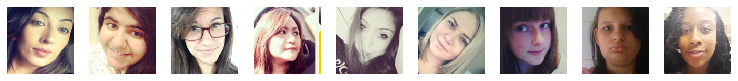

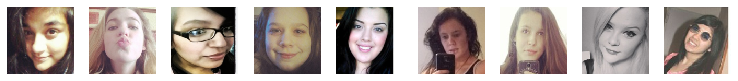

--------------------------------------------------------------------------------
Anime Faces


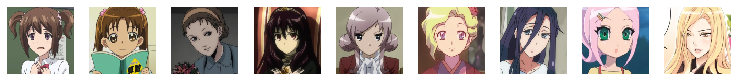

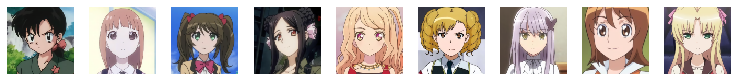

In [7]:
print ("Human Faces")
for k in range(2):
    plt.figure(figsize=(13, 13))
    for j in range(9):
        file = np.random.choice(faces)
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128,128))
        plt.subplot(990 + 1 + j)
        plt.imshow(img)
        plt.axis('off')
        #plt.title(trainY[i])
    plt.show()

print ("-"*80)
print ("Anime Faces")
for k in range(2):
    plt.figure(figsize=(13, 13))
    for j in range(9):
        file = np.random.choice(animes)
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128,128))
        plt.subplot(990 + 1 + j)
        plt.imshow(img)
        plt.axis('off')
        #plt.title(trainY[i])
    plt.show()

# Generator Model (U-Net Like)

In [8]:
import tensorflow_addons as tfa

In [9]:
def encoder_layer(input_layer, filters, bn=True):
    x = tensorflow.keras.layers.Conv2D(filters, kernel_size=(4,4), strides=(2,2), padding='same')(input_layer)
    x = tensorflow.keras.layers.LeakyReLU(alpha=0.2)(x)
    if bn:
        #x = tensorflow.keras.layers.BatchNormalization(momentum=0.8)(x)
        x = tfa.layers.InstanceNormalization()(x)
    return x

def decoder_layer(input_layer, skip_input, filters):
    #x = tensorflow.keras.layers.UpSampling2D(size=2)(input_layer)
    x = tensorflow.keras.layers.Conv2DTranspose(filters, kernel_size=(4,4), strides=(2,2), padding='same')(input_layer)
    x = tensorflow.keras.layers.Activation('relu')(x)
    #x = tensorflow.keras.layers.BatchNormalization(momentum=0.8)(x)
    x = tfa.layers.InstanceNormalization()(x)
    x = tensorflow.keras.layers.Concatenate()([x, skip_input])
    return x

In [10]:
def make_generator():
    source_image = tensorflow.keras.layers.Input(shape=(128, 128, 3))
    target_style = tensorflow.keras.layers.Input(shape=(16, 16, 512))

    e1 = encoder_layer(source_image, 64, bn=False)
    e2 = encoder_layer(e1, 128)
    e3 = encoder_layer(e2, 256)
    # e4 = encoder_layer(e3, 256)
    e5 = encoder_layer(e3, 512)
    e6 = encoder_layer(e5, 512)
    e7 = encoder_layer(e6, 512)

    bottle_neck = tensorflow.keras.layers.Conv2D(512, (4,4), strides=(2,2), padding='same')(e7)
    b = tensorflow.keras.layers.Activation('relu')(bottle_neck)

    d1 = decoder_layer(b, e7, 512)
    d2 = decoder_layer(d1, e6, 512)
    d3 = decoder_layer(d2, e5, 512)
    # d4 = decoder_layer(d3, e4, 256)
    d5 = decoder_layer(d3, e3, 256)
    d5 = tensorflow.keras.layers.Concatenate()([d5, target_style])
    d6 = decoder_layer(d5, e2, 128)
    d7 = decoder_layer(d6, e1, 64)

    decoded = tensorflow.keras.layers.Conv2DTranspose(3, kernel_size=(4,4), strides=(2,2), padding='same')(d7)
    translated_image = tensorflow.keras.layers.Activation('tanh')(decoded)
    return source_image, target_style, translated_image

source_image, target_style, translated_image = make_generator()
generator_network = tensorflow.keras.models.Model(inputs=[source_image, target_style], outputs=translated_image)
print (generator_network.summary())

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 64, 64, 64)   3136        input_1[0][0]                    
__________________________________________________________________________________________________
leaky_re_lu (LeakyReLU)         (None, 64, 64, 64)   0           conv2d[0][0]                     
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 32, 32, 128)  131200      leaky_re_lu[0][0]                
______________________________________________________________________________________________

# Discriminator Network

In [11]:
def my_conv_layer(input_layer, filters, bn=True):
    x = tensorflow.keras.layers.Conv2D(filters, kernel_size=(4,4), strides=(2,2), padding='same')(input_layer)
    x = tensorflow.keras.layers.LeakyReLU(alpha=0.2)(x)
    if bn:
        #x = tensorflow.keras.layers.BatchNormalization(momentum=0.8)(x)
        x = tfa.layers.InstanceNormalization()(x)
    return x

In [12]:
 def make_discriminator():
    target_image_input = tensorflow.keras.layers.Input(shape=(128, 128, 3))

    x = my_conv_layer(target_image_input, 64, bn=False)
    x = my_conv_layer(x, 128)
    x = my_conv_layer(x, 256)
    # x = my_conv_layer(x, 512)
    x = my_conv_layer(x, 512)

    patch_features = tensorflow.keras.layers.Conv2D(1, kernel_size=(4,4), strides=(1,1), padding='same')(x)
    return target_image_input, patch_features


target_image_input, patch_features = make_discriminator()
discriminator_network = tensorflow.keras.models.Model(inputs=target_image_input, outputs=patch_features)

print (discriminator_network.summary())

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 128, 128, 3)]     0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 64, 64, 64)        3136      
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 64, 64, 64)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 32, 32, 128)       131200    
_________________________________________________________________
leaky_re_lu_7 (LeakyReLU)    (None, 32, 32, 128)       0         
_________________________________________________________________
instance_normalization_11 (I (None, 32, 32, 128)       256       
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 16, 16, 256)       5245

In [13]:
adam_optimizer = tensorflow.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
discriminator_network.compile(loss='mse', optimizer=adam_optimizer, metrics=['accuracy'])

# VGG features

In [14]:
image_input = tensorflow.keras.layers.Input(shape=(128, 128, 3))

pre_trained_vgg = tensorflow.keras.applications.vgg19.VGG19(weights='imagenet', input_shape=(128, 128, 3), include_top=False)
pre_trained_vgg_model = tensorflow.keras.models.Model(inputs=pre_trained_vgg.input, outputs=pre_trained_vgg.get_layer('block4_conv4').output)

pre_trained_image_feautures = pre_trained_vgg_model(image_input)

custom_vgg = tensorflow.keras.models.Model(inputs=image_input, outputs=pre_trained_image_feautures)
print (custom_vgg.summary())

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 128, 128, 3)]     0         
_________________________________________________________________
model_2 (Functional)         (None, 16, 16, 512)       10585152  
Total params: 10,585,152
Trainable params: 10,585,152
Non-trainable params: 0
_________________________________________________________________
None


# Customized-Face2Anime-GAN

In [15]:
source_image = tensorflow.keras.layers.Input(shape=(128, 128, 3))
target_features = tensorflow.keras.layers.Input(shape=(16, 16, 512))

# Domain Transfer
custom_vgg.trainable=False
fake_anime = generator_network([source_image, target_features])
  
discriminator_network.trainable=False

# Tell Real vs Fake
real_vs_fake = discriminator_network(fake_anime)

face2anime_gan = tensorflow.keras.models.Model(inputs =[source_image, target_features], outputs = [real_vs_fake, fake_anime, fake_anime])
face2anime_gan.summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 128, 128, 3) 0                                            
__________________________________________________________________________________________________
input_7 (InputLayer)            [(None, 16, 16, 512) 0                                            
__________________________________________________________________________________________________
model (Functional)              (None, 128, 128, 3)  42882051    input_6[0][0]                    
                                                                 input_7[0][0]                    
__________________________________________________________________________________________________
model_1 (Functional)            (None, 8, 8, 1)      2766529     model[0][0]                

# Custom Content Loss (vgg features Loss)

In [16]:
def custom_content_loss(y_true, y_pred):
    custom_vgg.trainable=False
    y_true_features = custom_vgg(y_true)
    y_pred_features = custom_vgg(y_pred)
    content_loss = tensorflow.keras.losses.mean_absolute_error(y_true_features, y_pred_features)
    return content_loss

def custom_content_loss2(y_true, y_pred):
    custom_vgg.trainable=False
    y_true_features = y_true
    y_pred_features = custom_vgg(y_pred)
    content_loss = tensorflow.keras.losses.mean_absolute_error(y_true_features, y_pred_features)
    return content_loss

# Compiling Models

In [17]:
face2anime_gan.compile(loss=['mse', custom_content_loss, custom_content_loss],\
                       optimizer=adam_optimizer, loss_weights=[1, 1, 0.1])

# Define Data Generators

In [18]:
def faces_to_animes(faces, styles, generator_network):
    styles = custom_vgg(styles)
    generated_samples = generator_network.predict_on_batch([faces, styles])
    return generated_samples

def get_training_samples(batch_size):
    random_files = np.random.choice(faces, size=batch_size)
    images = []
    for file in random_files:
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128, 128))
        images.append((img-127.5)/127.5)
    face_images = np.array(images)

    random_files = np.random.choice(animes, size=batch_size)
    images = []
    for file in random_files:
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128, 128))
        images.append((img-127.5)/127.5)
    anime_images = np.array(images)
    return face_images, anime_images

def show_generator_results(generator_network):
    images = []
    styles = []
    for j in range(7):
        file = np.random.choice(faces_test)
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128, 128))
        images.append(img)

        file = np.random.choice(animes_test)
        img = cv2.imread(file)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (128, 128))
        styles.append(img)

    print ('Human Face Images')
    plt.figure(figsize=(13, 13))
    for j, img in enumerate(images):
        plt.subplot(770 + 1 + j)
        plt.imshow(img)
        plt.axis('off')
        #plt.title(trainY[i])
    plt.show()

    # print ('Style Images')
    # plt.figure(figsize=(13, 13))
    # for j, img in enumerate(styles):
    #     plt.subplot(770 + 1 + j)
    #     plt.imshow(img)
    #     plt.axis('off')
    #     #plt.title(trainY[i])
    # plt.show()

    print ('Customized Anime Version')
    plt.figure(figsize=(13, 13))
    for j, img in enumerate(images):
        img = (img-127.5)/127.5
        style = (styles[j]-127.5)/127.5
        output = faces_to_animes(np.array([img]), np.array([style]), generator_network)[0]
        output = (output+1.0)/2.0
        plt.subplot(770 + 1 + j)
        plt.imshow(output)
        plt.axis('off')
        #plt.title(trainY[i])
    plt.show()

# Training GAN

In [19]:
len(faces), len(animes)

(3400, 3400)

Human Face Images


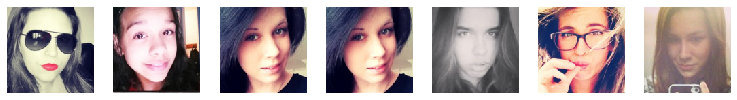

Customized Anime Version


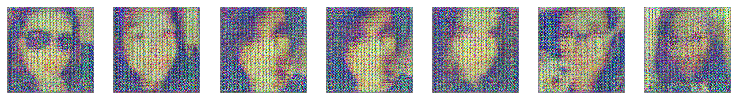

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_0/assets
Epoch:0, Step:0, D-Loss:0.830, D-Acc:51.562, G-Loss:2.577
Epoch:0, Step:100, D-Loss:0.312, D-Acc:64.062, G-Loss:2.376
Human Face Images


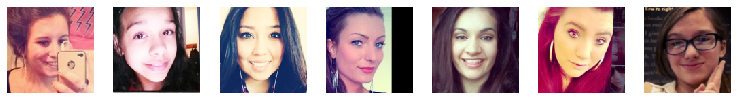

Customized Anime Version


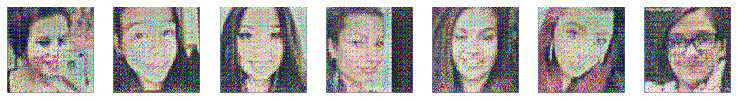

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_200/assets
Epoch:0, Step:200, D-Loss:0.222, D-Acc:75.781, G-Loss:2.188
Epoch:0, Step:300, D-Loss:0.364, D-Acc:52.344, G-Loss:2.029
Human Face Images


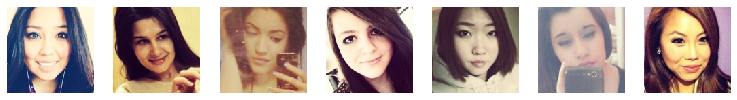

Customized Anime Version


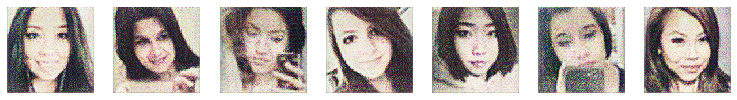

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_400/assets
Epoch:0, Step:400, D-Loss:0.316, D-Acc:56.250, G-Loss:1.901
Epoch:0, Step:500, D-Loss:0.218, D-Acc:71.875, G-Loss:1.592
Human Face Images


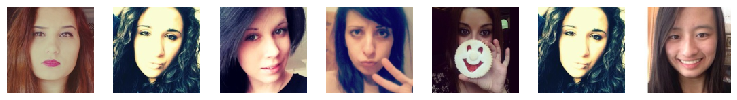

Customized Anime Version


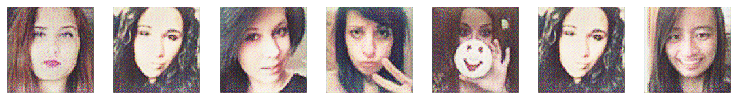

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_600/assets
Epoch:0, Step:600, D-Loss:0.215, D-Acc:69.531, G-Loss:1.717
Epoch:0, Step:700, D-Loss:0.151, D-Acc:80.469, G-Loss:1.599
Human Face Images


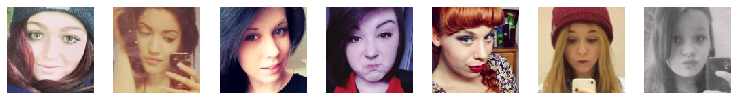

Customized Anime Version


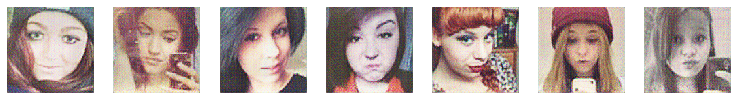

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_800/assets
Epoch:0, Step:800, D-Loss:0.340, D-Acc:50.000, G-Loss:1.295
Epoch:0, Step:900, D-Loss:0.310, D-Acc:61.719, G-Loss:1.493
Human Face Images


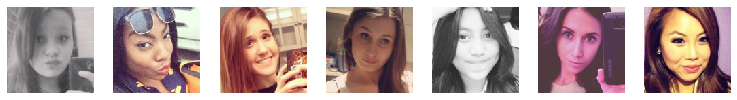

Customized Anime Version


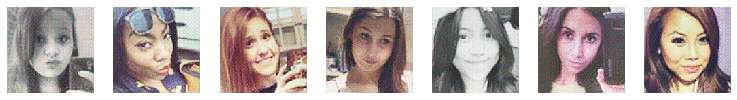

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_1000/assets
Epoch:0, Step:1000, D-Loss:0.324, D-Acc:62.500, G-Loss:1.324
Epoch:0, Step:1100, D-Loss:0.128, D-Acc:83.594, G-Loss:1.334
Human Face Images


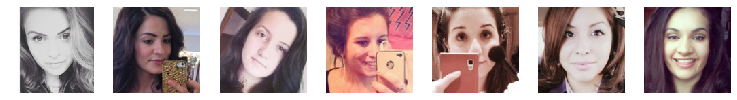

Customized Anime Version


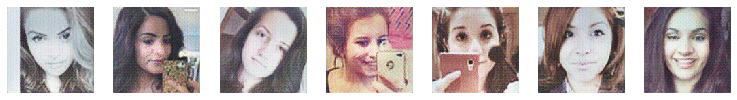

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_1200/assets
Epoch:0, Step:1200, D-Loss:0.193, D-Acc:73.438, G-Loss:1.606
Epoch:0, Step:1300, D-Loss:0.266, D-Acc:53.906, G-Loss:1.167
Human Face Images


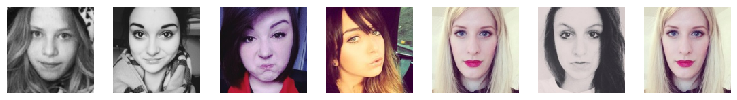

Customized Anime Version


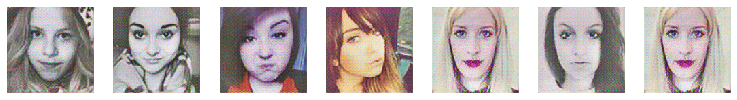

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_1400/assets
Epoch:0, Step:1400, D-Loss:0.231, D-Acc:68.750, G-Loss:1.307
Epoch:0, Step:1500, D-Loss:0.301, D-Acc:55.469, G-Loss:1.072
Human Face Images


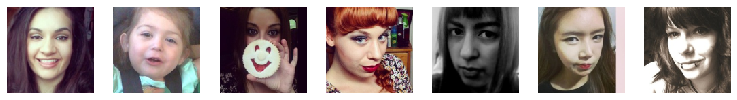

Customized Anime Version


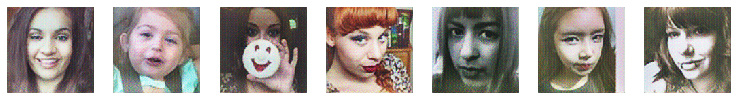

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_1600/assets
Epoch:0, Step:1600, D-Loss:0.233, D-Acc:63.281, G-Loss:1.246
Epoch:0, Step:1700, D-Loss:0.239, D-Acc:71.875, G-Loss:1.424
Human Face Images


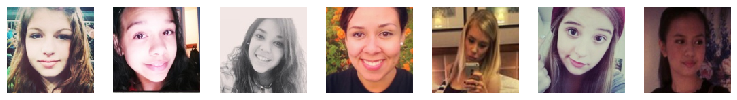

Customized Anime Version


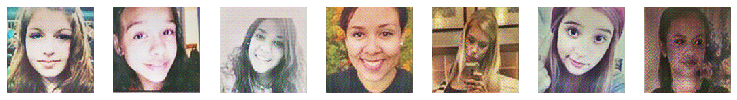

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_1800/assets
Epoch:0, Step:1800, D-Loss:0.434, D-Acc:46.094, G-Loss:1.413
Epoch:0, Step:1900, D-Loss:0.144, D-Acc:83.594, G-Loss:1.116
Human Face Images


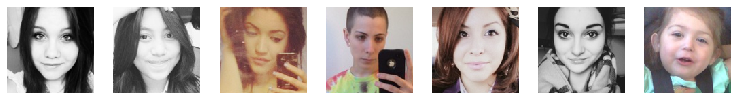

Customized Anime Version


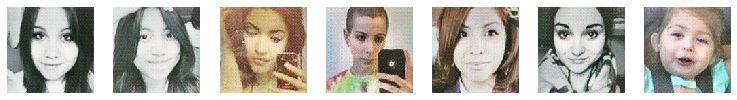

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_2000/assets
Epoch:0, Step:2000, D-Loss:0.246, D-Acc:60.156, G-Loss:1.120
Epoch:0, Step:2100, D-Loss:0.124, D-Acc:85.938, G-Loss:1.328
Human Face Images


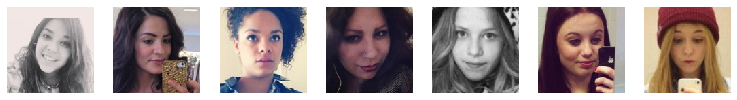

Customized Anime Version


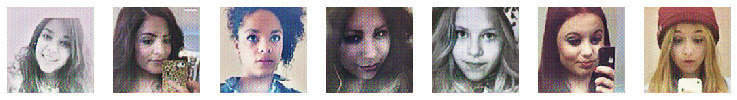

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_2200/assets
Epoch:0, Step:2200, D-Loss:0.167, D-Acc:74.219, G-Loss:1.395
Epoch:0, Step:2300, D-Loss:0.186, D-Acc:75.000, G-Loss:1.438
Human Face Images


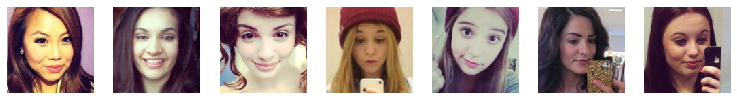

Customized Anime Version


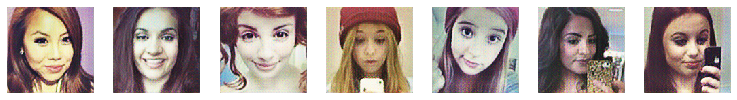

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_2400/assets
Epoch:0, Step:2400, D-Loss:0.186, D-Acc:69.531, G-Loss:1.219
Epoch:0, Step:2500, D-Loss:0.197, D-Acc:71.875, G-Loss:1.280
Human Face Images


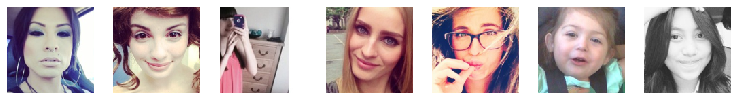

Customized Anime Version


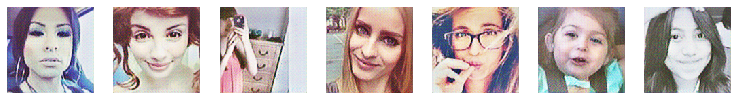

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_2600/assets
Epoch:0, Step:2600, D-Loss:0.131, D-Acc:85.156, G-Loss:1.343
Epoch:0, Step:2700, D-Loss:0.110, D-Acc:89.062, G-Loss:1.427
Human Face Images


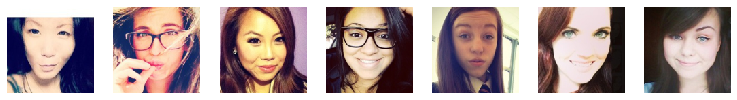

Customized Anime Version


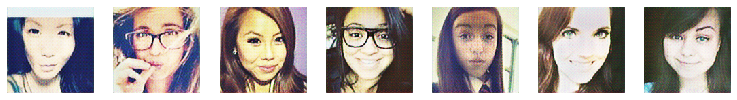

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_2800/assets
Epoch:0, Step:2800, D-Loss:0.321, D-Acc:62.500, G-Loss:1.292
Epoch:0, Step:2900, D-Loss:0.179, D-Acc:75.781, G-Loss:1.535
Human Face Images


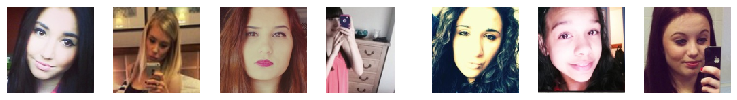

Customized Anime Version


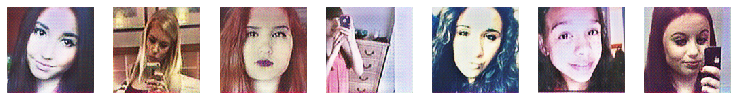

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_3000/assets
Epoch:0, Step:3000, D-Loss:0.478, D-Acc:28.906, G-Loss:1.229
Epoch:0, Step:3100, D-Loss:0.316, D-Acc:50.000, G-Loss:1.390
Human Face Images


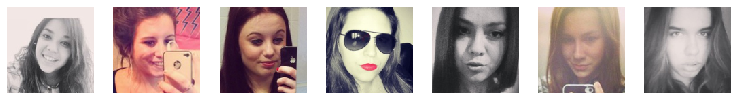

Customized Anime Version


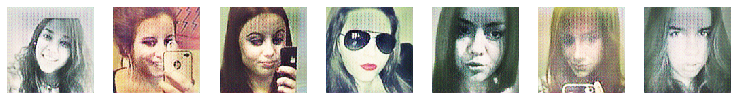

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_0_3200/assets
Epoch:0, Step:3200, D-Loss:0.208, D-Acc:68.750, G-Loss:1.733
Epoch:0, Step:3300, D-Loss:0.115, D-Acc:88.281, G-Loss:1.664
Human Face Images


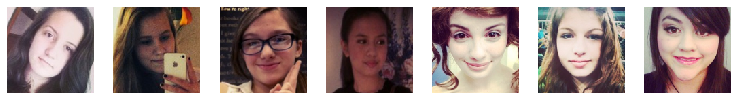

Customized Anime Version


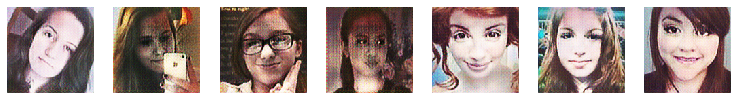

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_0/assets
Epoch:1, Step:0, D-Loss:0.185, D-Acc:74.219, G-Loss:1.623
Epoch:1, Step:100, D-Loss:0.099, D-Acc:89.844, G-Loss:1.421
Human Face Images


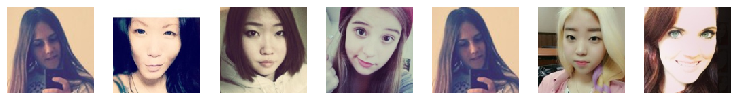

Customized Anime Version


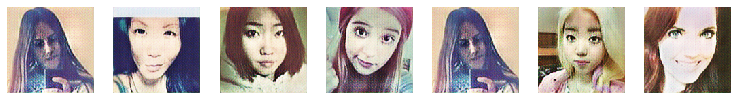

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_200/assets
Epoch:1, Step:200, D-Loss:0.208, D-Acc:71.094, G-Loss:1.782
Epoch:1, Step:300, D-Loss:0.226, D-Acc:76.562, G-Loss:1.525
Human Face Images


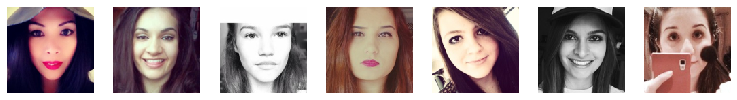

Customized Anime Version


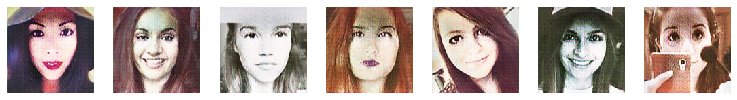

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_400/assets
Epoch:1, Step:400, D-Loss:0.306, D-Acc:52.344, G-Loss:1.652
Epoch:1, Step:500, D-Loss:0.123, D-Acc:82.812, G-Loss:1.600
Human Face Images


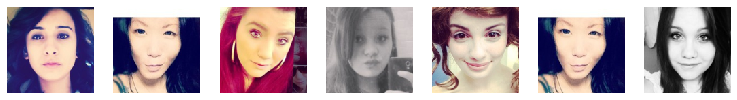

Customized Anime Version


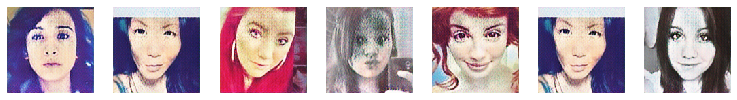

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_600/assets
Epoch:1, Step:600, D-Loss:0.191, D-Acc:75.000, G-Loss:1.636
Epoch:1, Step:700, D-Loss:0.189, D-Acc:70.312, G-Loss:1.568
Human Face Images


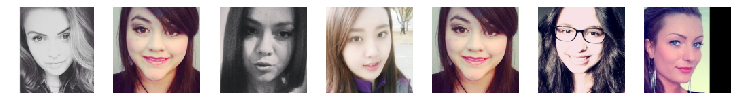

Customized Anime Version


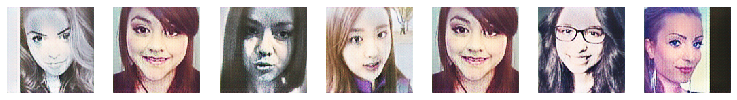

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_800/assets
Epoch:1, Step:800, D-Loss:0.230, D-Acc:63.281, G-Loss:1.513
Epoch:1, Step:900, D-Loss:0.197, D-Acc:68.750, G-Loss:1.557
Human Face Images


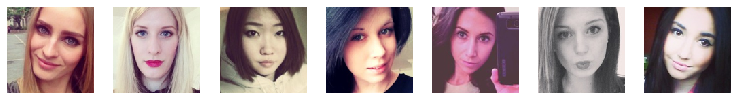

Customized Anime Version


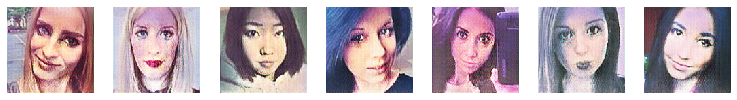

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_1000/assets
Epoch:1, Step:1000, D-Loss:0.408, D-Acc:43.750, G-Loss:1.698
Epoch:1, Step:1100, D-Loss:0.245, D-Acc:61.719, G-Loss:1.485
Human Face Images


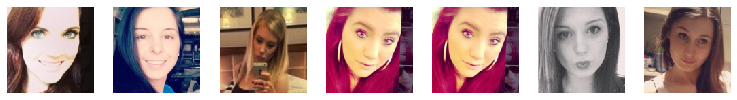

Customized Anime Version


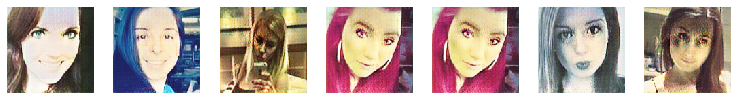

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_1200/assets
Epoch:1, Step:1200, D-Loss:0.114, D-Acc:85.156, G-Loss:1.748
Epoch:1, Step:1300, D-Loss:0.135, D-Acc:85.156, G-Loss:1.947
Human Face Images


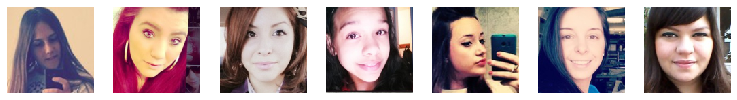

Customized Anime Version


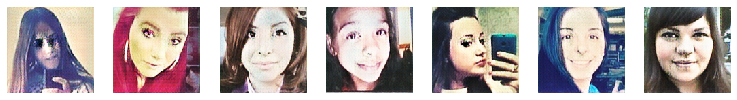

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_1400/assets
Epoch:1, Step:1400, D-Loss:0.225, D-Acc:76.562, G-Loss:1.650
Epoch:1, Step:1500, D-Loss:0.220, D-Acc:71.875, G-Loss:1.848
Human Face Images


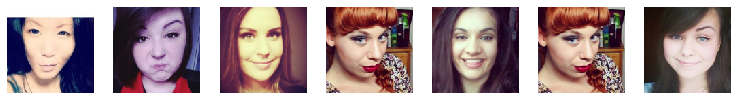

Customized Anime Version


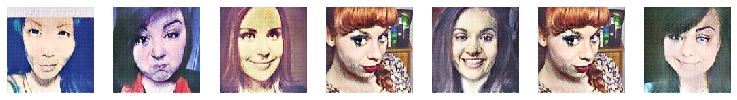

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_1600/assets
Epoch:1, Step:1600, D-Loss:0.247, D-Acc:57.812, G-Loss:1.651
Epoch:1, Step:1700, D-Loss:0.210, D-Acc:76.562, G-Loss:1.946
Human Face Images


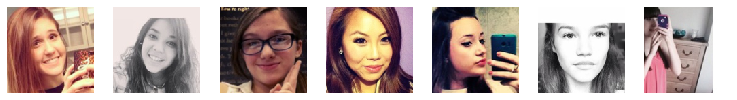

Customized Anime Version


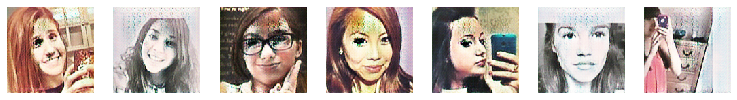

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_1800/assets
Epoch:1, Step:1800, D-Loss:0.107, D-Acc:88.281, G-Loss:1.788
Epoch:1, Step:1900, D-Loss:0.161, D-Acc:77.344, G-Loss:1.837
Human Face Images


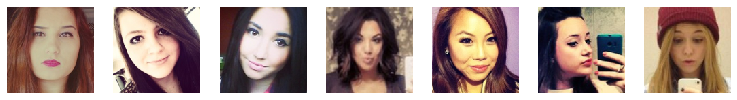

Customized Anime Version


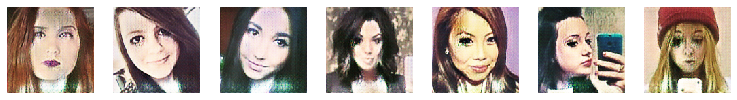

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_2000/assets
Epoch:1, Step:2000, D-Loss:0.167, D-Acc:77.344, G-Loss:1.840
Epoch:1, Step:2100, D-Loss:0.115, D-Acc:85.938, G-Loss:1.769
Human Face Images


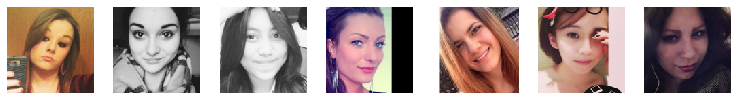

Customized Anime Version


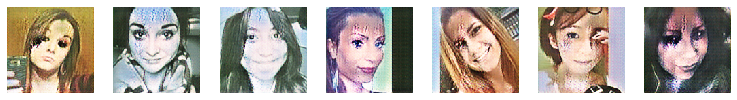

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_2200/assets
Epoch:1, Step:2200, D-Loss:0.227, D-Acc:60.938, G-Loss:1.821
Epoch:1, Step:2300, D-Loss:0.130, D-Acc:79.688, G-Loss:1.813
Human Face Images


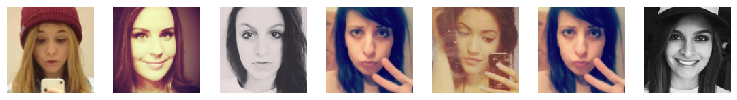

Customized Anime Version


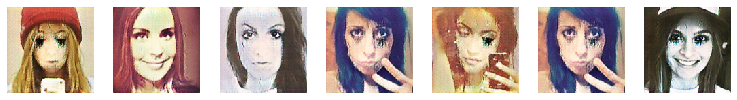

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_2400/assets
Epoch:1, Step:2400, D-Loss:0.063, D-Acc:98.438, G-Loss:1.957
Epoch:1, Step:2500, D-Loss:0.165, D-Acc:84.375, G-Loss:1.995
Human Face Images


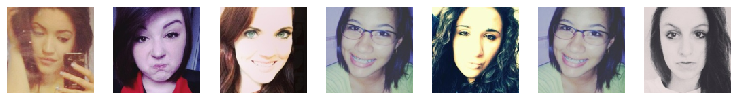

Customized Anime Version


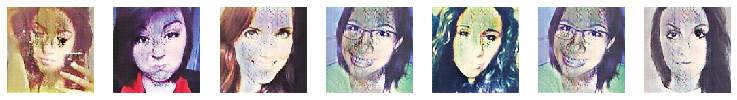

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_2600/assets
Epoch:1, Step:2600, D-Loss:0.075, D-Acc:95.312, G-Loss:2.056
Epoch:1, Step:2700, D-Loss:0.162, D-Acc:77.344, G-Loss:1.903
Human Face Images


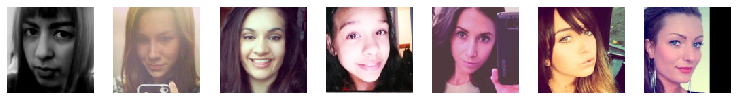

Customized Anime Version


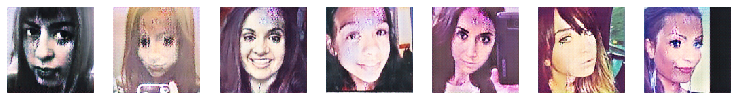

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_2800/assets
Epoch:1, Step:2800, D-Loss:0.147, D-Acc:82.812, G-Loss:1.795
Epoch:1, Step:2900, D-Loss:0.119, D-Acc:87.500, G-Loss:1.889
Human Face Images


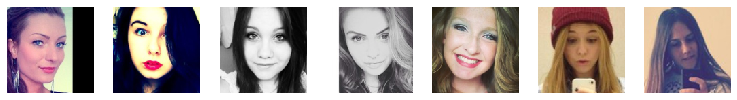

Customized Anime Version


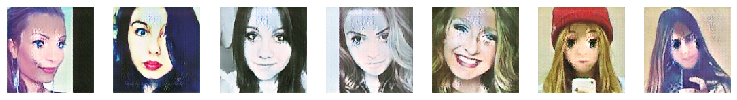

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_3000/assets
Epoch:1, Step:3000, D-Loss:0.185, D-Acc:73.438, G-Loss:1.682
Epoch:1, Step:3100, D-Loss:0.350, D-Acc:53.125, G-Loss:2.860
Human Face Images


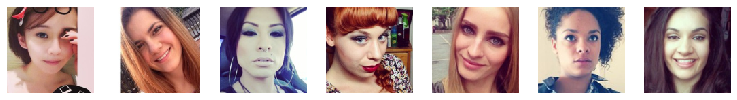

Customized Anime Version


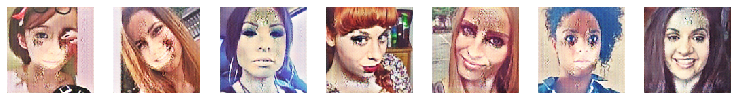

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_1_3200/assets
Epoch:1, Step:3200, D-Loss:0.174, D-Acc:79.688, G-Loss:1.987
Epoch:1, Step:3300, D-Loss:0.186, D-Acc:75.781, G-Loss:1.781
Human Face Images


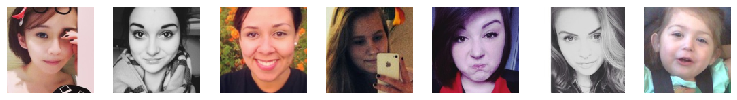

Customized Anime Version


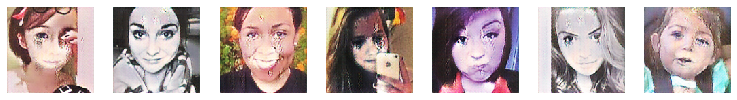

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_0/assets
Epoch:2, Step:0, D-Loss:0.065, D-Acc:98.438, G-Loss:1.768
Epoch:2, Step:100, D-Loss:0.071, D-Acc:92.188, G-Loss:1.802
Human Face Images


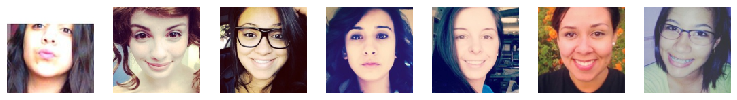

Customized Anime Version


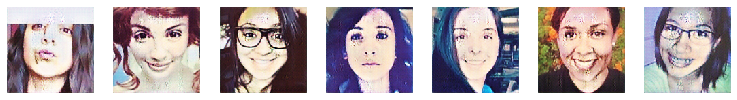

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_200/assets
Epoch:2, Step:200, D-Loss:0.110, D-Acc:90.625, G-Loss:1.826
Epoch:2, Step:300, D-Loss:0.328, D-Acc:64.062, G-Loss:2.134
Human Face Images


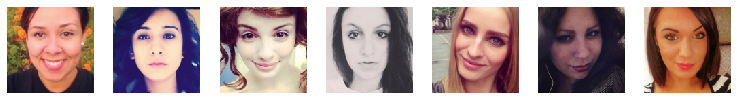

Customized Anime Version


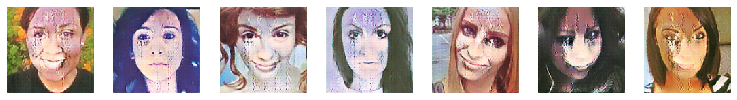

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_400/assets
Epoch:2, Step:400, D-Loss:0.374, D-Acc:46.875, G-Loss:2.091
Epoch:2, Step:500, D-Loss:0.342, D-Acc:42.969, G-Loss:2.209
Human Face Images


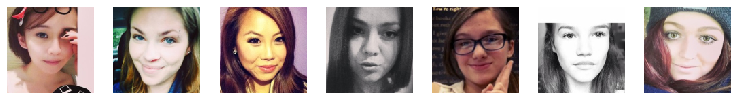

Customized Anime Version


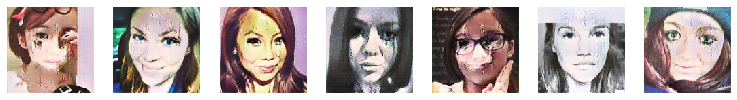

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_600/assets
Epoch:2, Step:600, D-Loss:0.084, D-Acc:92.188, G-Loss:1.880
Epoch:2, Step:700, D-Loss:0.222, D-Acc:69.531, G-Loss:1.867
Human Face Images


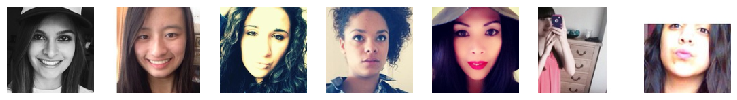

Customized Anime Version


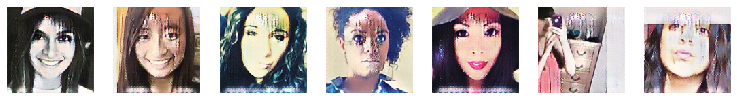

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_800/assets
Epoch:2, Step:800, D-Loss:0.115, D-Acc:83.594, G-Loss:2.253
Epoch:2, Step:900, D-Loss:0.036, D-Acc:100.000, G-Loss:2.323
Human Face Images


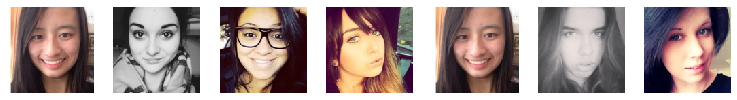

Customized Anime Version


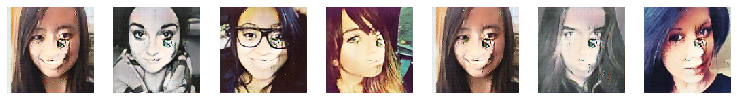

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_1000/assets
Epoch:2, Step:1000, D-Loss:0.195, D-Acc:75.781, G-Loss:1.927
Epoch:2, Step:1100, D-Loss:0.112, D-Acc:86.719, G-Loss:2.135
Human Face Images


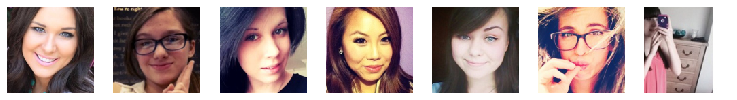

Customized Anime Version


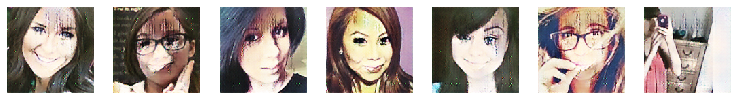

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_1200/assets
Epoch:2, Step:1200, D-Loss:0.141, D-Acc:82.812, G-Loss:1.977
Epoch:2, Step:1300, D-Loss:0.122, D-Acc:85.938, G-Loss:1.908
Human Face Images


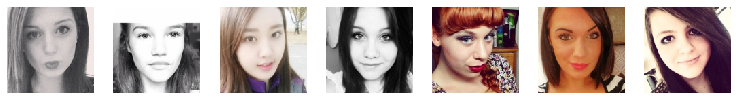

Customized Anime Version


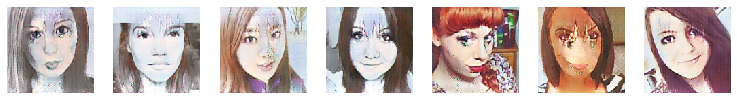

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_1400/assets
Epoch:2, Step:1400, D-Loss:0.081, D-Acc:95.312, G-Loss:1.941
Epoch:2, Step:1500, D-Loss:0.334, D-Acc:40.625, G-Loss:1.821
Human Face Images


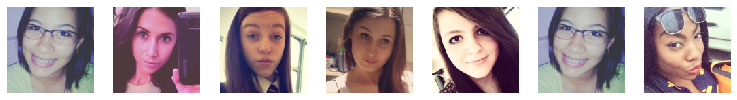

Customized Anime Version


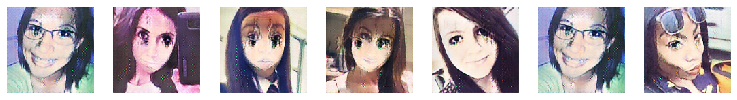

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_1600/assets
Epoch:2, Step:1600, D-Loss:0.218, D-Acc:61.719, G-Loss:1.979
Epoch:2, Step:1700, D-Loss:0.124, D-Acc:88.281, G-Loss:2.031
Human Face Images


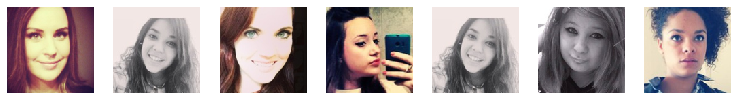

Customized Anime Version


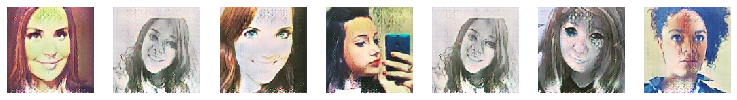

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_1800/assets
Epoch:2, Step:1800, D-Loss:0.268, D-Acc:75.000, G-Loss:2.030
Epoch:2, Step:1900, D-Loss:0.026, D-Acc:100.000, G-Loss:1.933
Human Face Images


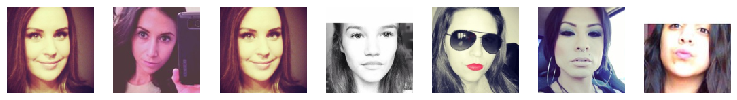

Customized Anime Version


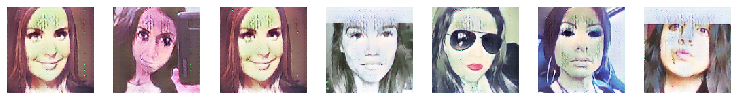

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_2000/assets
Epoch:2, Step:2000, D-Loss:0.118, D-Acc:87.500, G-Loss:2.040
Epoch:2, Step:2100, D-Loss:0.102, D-Acc:90.625, G-Loss:2.375
Human Face Images


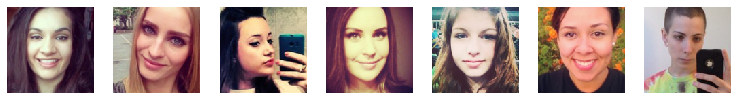

Customized Anime Version


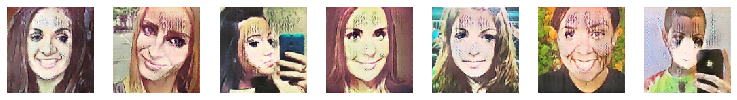

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_2200/assets
Epoch:2, Step:2200, D-Loss:0.045, D-Acc:97.656, G-Loss:2.238
Epoch:2, Step:2300, D-Loss:0.212, D-Acc:68.750, G-Loss:1.788
Human Face Images


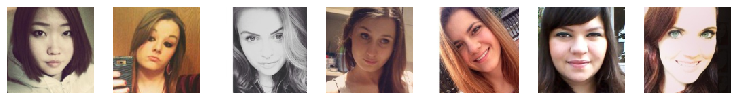

Customized Anime Version


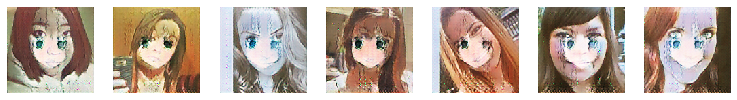

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_2400/assets
Epoch:2, Step:2400, D-Loss:0.042, D-Acc:100.000, G-Loss:2.449
Epoch:2, Step:2500, D-Loss:0.073, D-Acc:94.531, G-Loss:2.055
Human Face Images


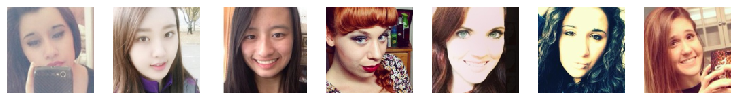

Customized Anime Version


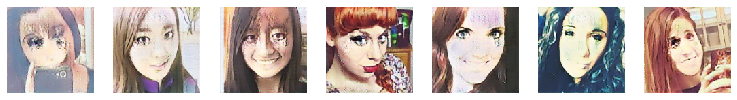

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_2600/assets
Epoch:2, Step:2600, D-Loss:0.044, D-Acc:100.000, G-Loss:1.893
Epoch:2, Step:2700, D-Loss:0.246, D-Acc:60.938, G-Loss:2.132
Human Face Images


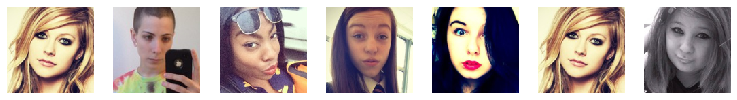

Customized Anime Version


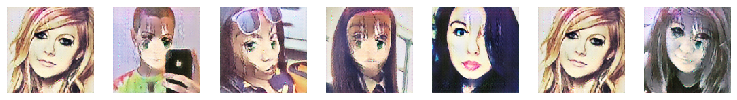

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_2800/assets
Epoch:2, Step:2800, D-Loss:0.051, D-Acc:98.438, G-Loss:1.966
Epoch:2, Step:2900, D-Loss:0.035, D-Acc:100.000, G-Loss:2.127
Human Face Images


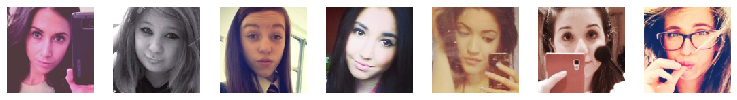

Customized Anime Version


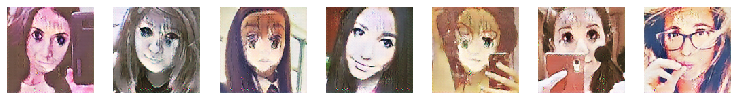

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_3000/assets
Epoch:2, Step:3000, D-Loss:0.084, D-Acc:96.875, G-Loss:2.262
Epoch:2, Step:3100, D-Loss:0.114, D-Acc:90.625, G-Loss:2.011
Human Face Images


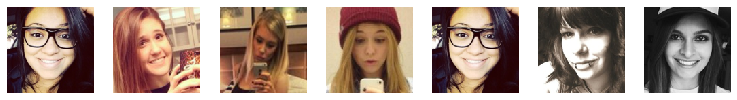

Customized Anime Version


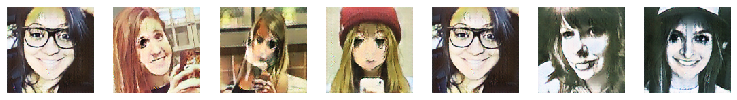

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_2_3200/assets
Epoch:2, Step:3200, D-Loss:0.078, D-Acc:97.656, G-Loss:2.093
Epoch:2, Step:3300, D-Loss:0.053, D-Acc:99.219, G-Loss:2.108
Human Face Images


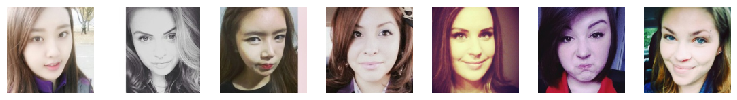

Customized Anime Version


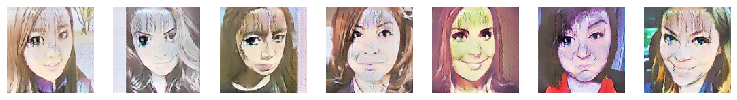

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_0/assets
Epoch:3, Step:0, D-Loss:0.096, D-Acc:89.844, G-Loss:2.192
Epoch:3, Step:100, D-Loss:0.085, D-Acc:93.750, G-Loss:2.138
Human Face Images


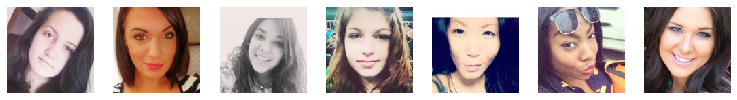

Customized Anime Version


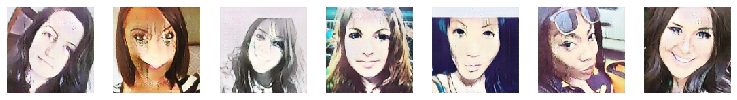

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_200/assets
Epoch:3, Step:200, D-Loss:0.059, D-Acc:100.000, G-Loss:2.184
Epoch:3, Step:300, D-Loss:0.247, D-Acc:66.406, G-Loss:1.980
Human Face Images


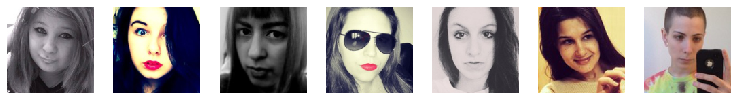

Customized Anime Version


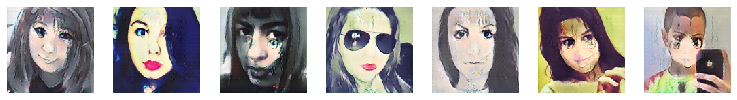

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_400/assets
Epoch:3, Step:400, D-Loss:0.128, D-Acc:82.812, G-Loss:1.863
Epoch:3, Step:500, D-Loss:0.046, D-Acc:100.000, G-Loss:1.933
Human Face Images


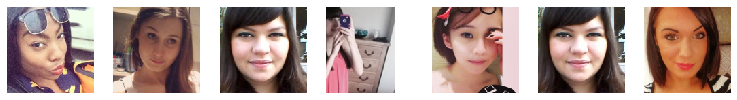

Customized Anime Version


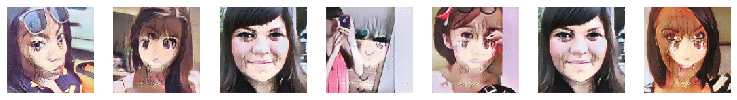

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_600/assets
Epoch:3, Step:600, D-Loss:0.090, D-Acc:90.625, G-Loss:2.111
Epoch:3, Step:700, D-Loss:0.097, D-Acc:88.281, G-Loss:2.072
Human Face Images


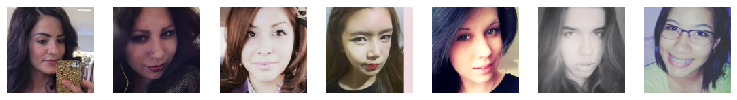

Customized Anime Version


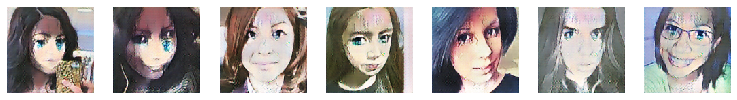

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_800/assets
Epoch:3, Step:800, D-Loss:0.027, D-Acc:100.000, G-Loss:1.977
Epoch:3, Step:900, D-Loss:0.513, D-Acc:29.688, G-Loss:1.924
Human Face Images


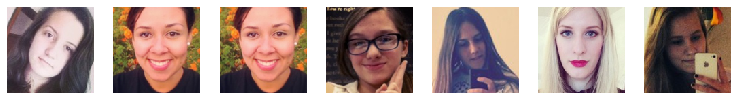

Customized Anime Version


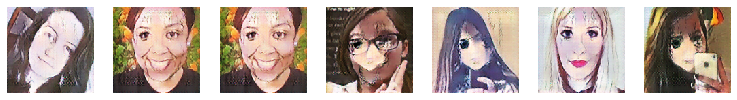

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_1000/assets
Epoch:3, Step:1000, D-Loss:0.119, D-Acc:91.406, G-Loss:2.267
Epoch:3, Step:1100, D-Loss:0.141, D-Acc:82.031, G-Loss:2.186
Human Face Images


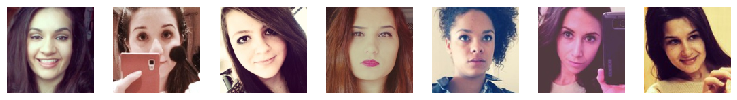

Customized Anime Version


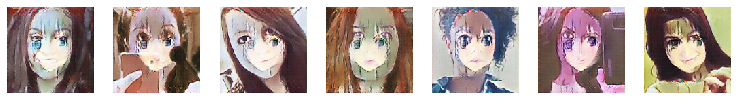

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_1200/assets
Epoch:3, Step:1200, D-Loss:0.023, D-Acc:100.000, G-Loss:2.286
Epoch:3, Step:1300, D-Loss:0.118, D-Acc:86.719, G-Loss:1.916
Human Face Images


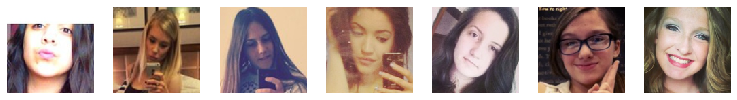

Customized Anime Version


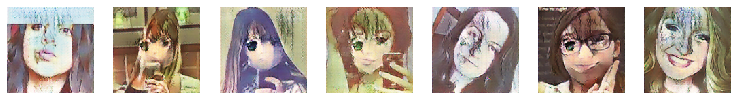

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_1400/assets
Epoch:3, Step:1400, D-Loss:0.088, D-Acc:99.219, G-Loss:2.426
Epoch:3, Step:1500, D-Loss:0.122, D-Acc:89.062, G-Loss:1.978
Human Face Images


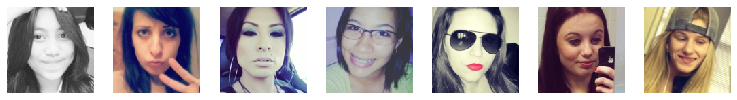

Customized Anime Version


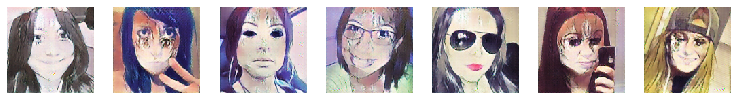

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_1600/assets
Epoch:3, Step:1600, D-Loss:0.277, D-Acc:60.156, G-Loss:2.172
Epoch:3, Step:1700, D-Loss:0.149, D-Acc:76.562, G-Loss:2.016
Human Face Images


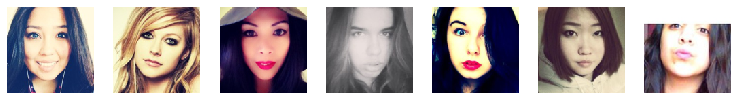

Customized Anime Version


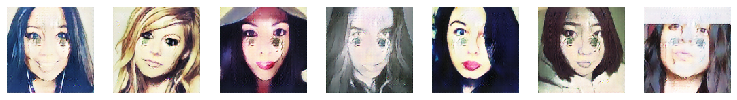

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_1800/assets
Epoch:3, Step:1800, D-Loss:0.065, D-Acc:96.094, G-Loss:1.979
Epoch:3, Step:1900, D-Loss:0.034, D-Acc:97.656, G-Loss:2.240
Human Face Images


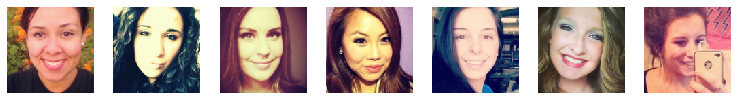

Customized Anime Version


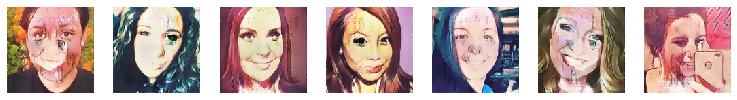

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_2000/assets
Epoch:3, Step:2000, D-Loss:0.113, D-Acc:88.281, G-Loss:2.083
Epoch:3, Step:2100, D-Loss:0.149, D-Acc:74.219, G-Loss:2.187
Human Face Images


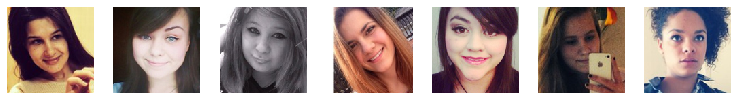

Customized Anime Version


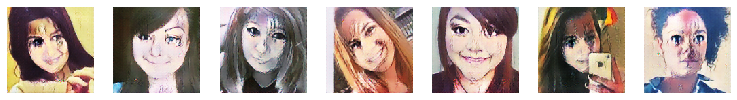

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_2200/assets
Epoch:3, Step:2200, D-Loss:0.102, D-Acc:85.938, G-Loss:1.981
Epoch:3, Step:2300, D-Loss:0.045, D-Acc:100.000, G-Loss:2.054
Human Face Images


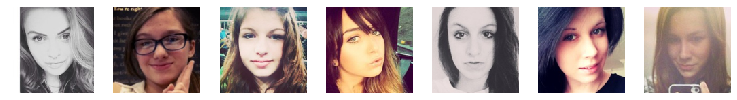

Customized Anime Version


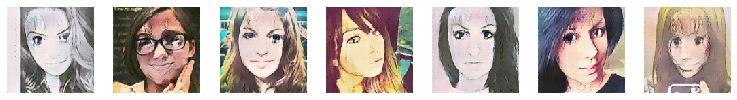

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_2400/assets
Epoch:3, Step:2400, D-Loss:0.051, D-Acc:96.875, G-Loss:1.919
Epoch:3, Step:2500, D-Loss:0.223, D-Acc:65.625, G-Loss:2.376
Human Face Images


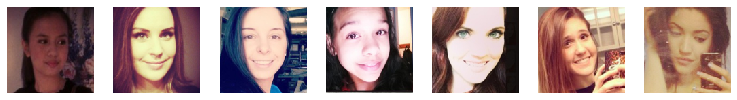

Customized Anime Version


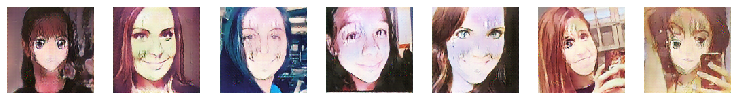

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_2600/assets
Epoch:3, Step:2600, D-Loss:0.038, D-Acc:99.219, G-Loss:2.185
Epoch:3, Step:2700, D-Loss:0.048, D-Acc:95.312, G-Loss:1.906
Human Face Images


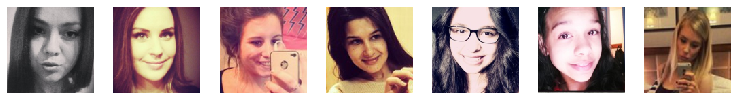

Customized Anime Version


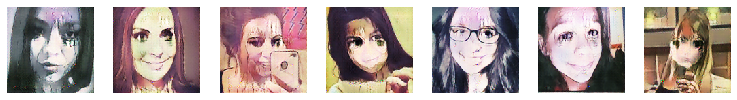

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_2800/assets
Epoch:3, Step:2800, D-Loss:0.148, D-Acc:81.250, G-Loss:1.928
Epoch:3, Step:2900, D-Loss:0.037, D-Acc:100.000, G-Loss:2.238
Human Face Images


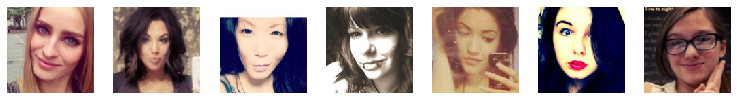

Customized Anime Version


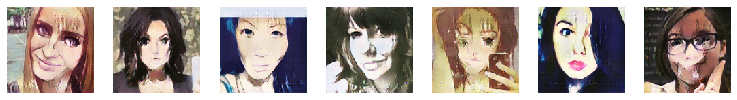

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_3000/assets
Epoch:3, Step:3000, D-Loss:0.044, D-Acc:99.219, G-Loss:2.162
Epoch:3, Step:3100, D-Loss:0.091, D-Acc:93.750, G-Loss:2.101
Human Face Images


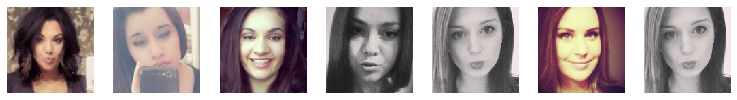

Customized Anime Version


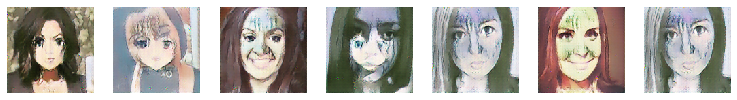

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_3_3200/assets
Epoch:3, Step:3200, D-Loss:0.039, D-Acc:98.438, G-Loss:2.090
Epoch:3, Step:3300, D-Loss:0.145, D-Acc:81.250, G-Loss:2.100
Human Face Images


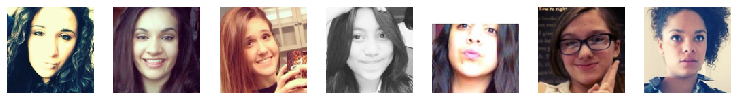

Customized Anime Version


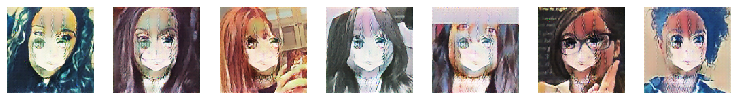

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_0/assets
Epoch:4, Step:0, D-Loss:0.421, D-Acc:24.219, G-Loss:2.321
Epoch:4, Step:100, D-Loss:0.054, D-Acc:100.000, G-Loss:2.398
Human Face Images


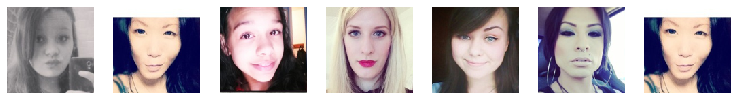

Customized Anime Version


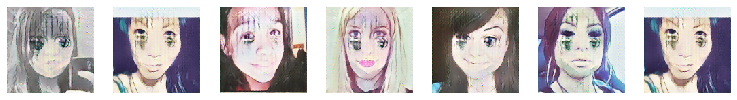

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_200/assets
Epoch:4, Step:200, D-Loss:0.061, D-Acc:97.656, G-Loss:1.968
Epoch:4, Step:300, D-Loss:0.045, D-Acc:99.219, G-Loss:2.270
Human Face Images


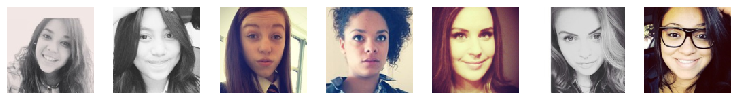

Customized Anime Version


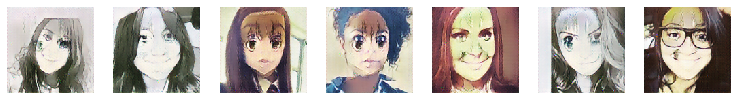

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_400/assets
Epoch:4, Step:400, D-Loss:0.186, D-Acc:76.562, G-Loss:2.200
Epoch:4, Step:500, D-Loss:0.047, D-Acc:98.438, G-Loss:2.100
Human Face Images


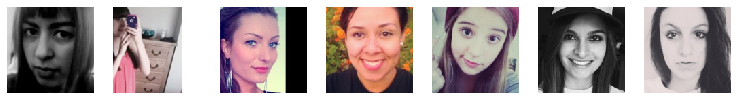

Customized Anime Version


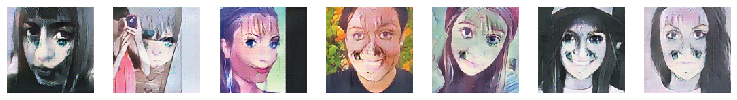

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_600/assets
Epoch:4, Step:600, D-Loss:0.195, D-Acc:67.188, G-Loss:2.027
Epoch:4, Step:700, D-Loss:0.096, D-Acc:92.969, G-Loss:1.923
Human Face Images


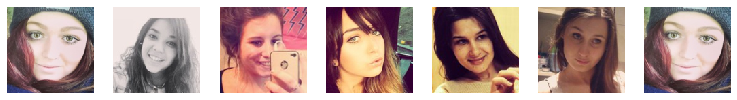

Customized Anime Version


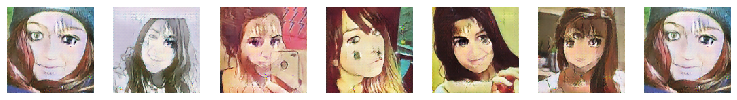

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_800/assets
Epoch:4, Step:800, D-Loss:0.050, D-Acc:99.219, G-Loss:2.278
Epoch:4, Step:900, D-Loss:0.109, D-Acc:90.625, G-Loss:2.173
Human Face Images


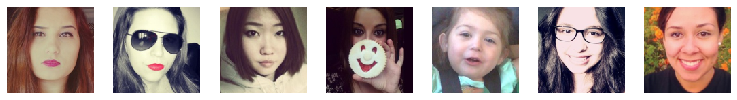

Customized Anime Version


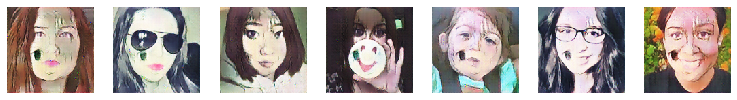

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_1000/assets
Epoch:4, Step:1000, D-Loss:0.053, D-Acc:96.875, G-Loss:2.061
Epoch:4, Step:1100, D-Loss:0.037, D-Acc:100.000, G-Loss:2.148
Human Face Images


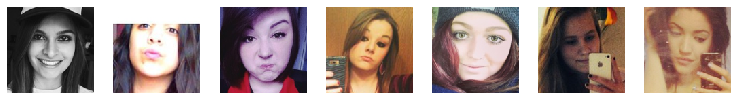

Customized Anime Version


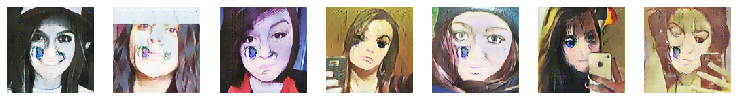

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_1200/assets
Epoch:4, Step:1200, D-Loss:0.107, D-Acc:93.750, G-Loss:2.218
Epoch:4, Step:1300, D-Loss:0.029, D-Acc:99.219, G-Loss:2.050
Human Face Images


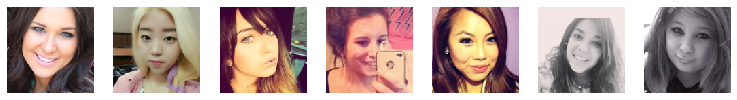

Customized Anime Version


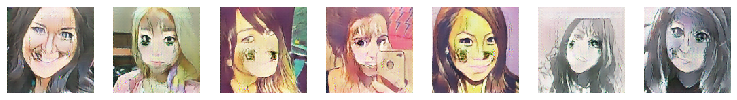

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_1400/assets
Epoch:4, Step:1400, D-Loss:0.262, D-Acc:60.156, G-Loss:1.910
Epoch:4, Step:1500, D-Loss:0.036, D-Acc:99.219, G-Loss:2.426
Human Face Images


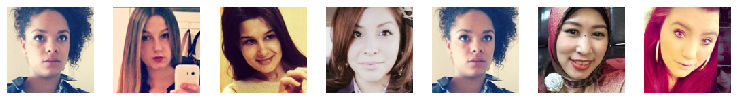

Customized Anime Version


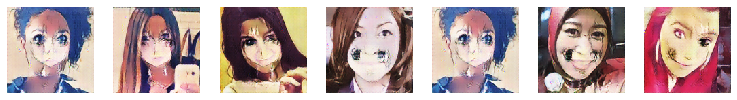

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_1600/assets
Epoch:4, Step:1600, D-Loss:0.054, D-Acc:99.219, G-Loss:2.476
Epoch:4, Step:1700, D-Loss:0.047, D-Acc:98.438, G-Loss:2.158
Human Face Images


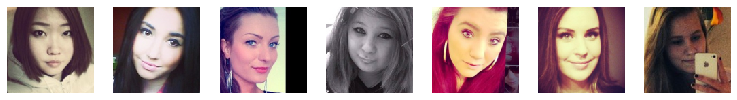

Customized Anime Version


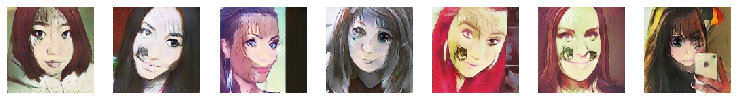

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_1800/assets
Epoch:4, Step:1800, D-Loss:0.094, D-Acc:92.969, G-Loss:2.649
Epoch:4, Step:1900, D-Loss:0.237, D-Acc:57.031, G-Loss:2.079
Human Face Images


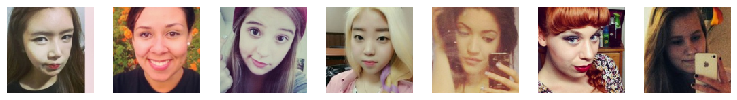

Customized Anime Version


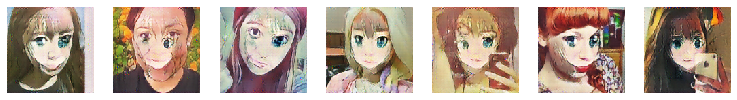

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_2000/assets
Epoch:4, Step:2000, D-Loss:0.066, D-Acc:96.875, G-Loss:2.148
Epoch:4, Step:2100, D-Loss:0.097, D-Acc:86.719, G-Loss:2.013
Human Face Images


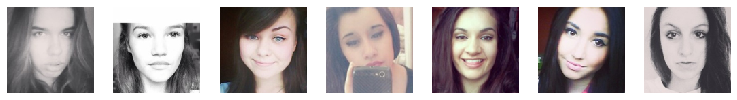

Customized Anime Version


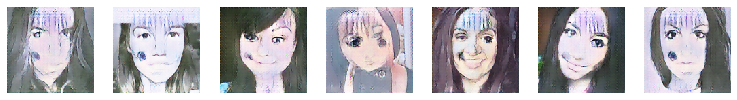

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_2200/assets
Epoch:4, Step:2200, D-Loss:0.135, D-Acc:84.375, G-Loss:2.311
Epoch:4, Step:2300, D-Loss:0.049, D-Acc:100.000, G-Loss:2.406
Human Face Images


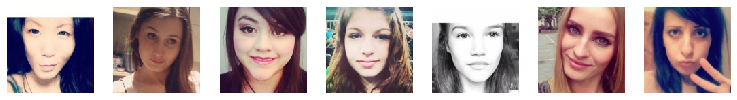

Customized Anime Version


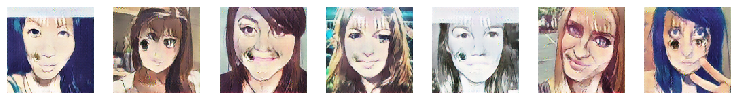

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_2400/assets
Epoch:4, Step:2400, D-Loss:0.164, D-Acc:75.781, G-Loss:1.997
Epoch:4, Step:2500, D-Loss:0.041, D-Acc:100.000, G-Loss:2.257
Human Face Images


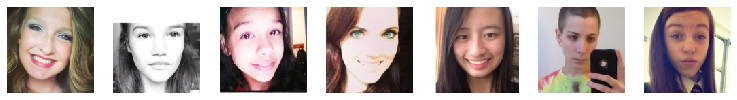

Customized Anime Version


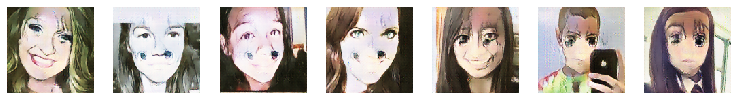

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_2600/assets
Epoch:4, Step:2600, D-Loss:0.037, D-Acc:99.219, G-Loss:1.885
Epoch:4, Step:2700, D-Loss:0.033, D-Acc:99.219, G-Loss:2.462
Human Face Images


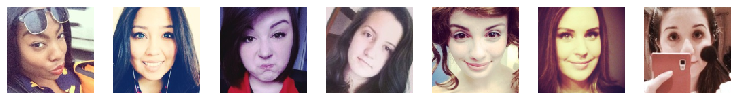

Customized Anime Version


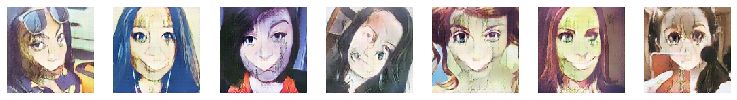

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_2800/assets
Epoch:4, Step:2800, D-Loss:0.035, D-Acc:100.000, G-Loss:2.112
Epoch:4, Step:2900, D-Loss:0.216, D-Acc:66.406, G-Loss:2.269
Human Face Images


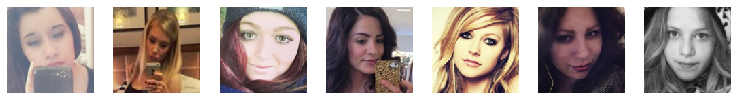

Customized Anime Version


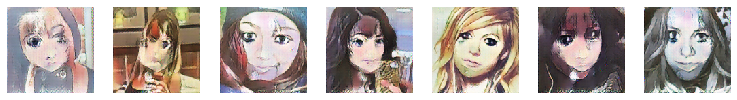

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_3000/assets
Epoch:4, Step:3000, D-Loss:0.051, D-Acc:100.000, G-Loss:2.144
Epoch:4, Step:3100, D-Loss:0.207, D-Acc:65.625, G-Loss:2.069
Human Face Images


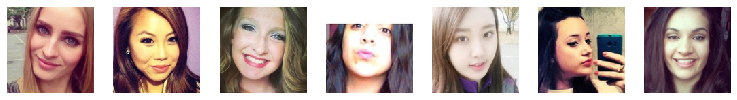

Customized Anime Version


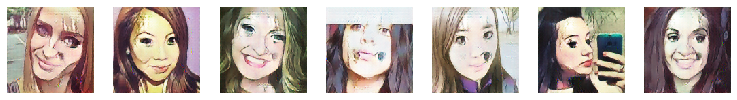

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_4_3200/assets
Epoch:4, Step:3200, D-Loss:0.040, D-Acc:98.438, G-Loss:2.275
Epoch:4, Step:3300, D-Loss:0.067, D-Acc:96.094, G-Loss:2.032
Human Face Images


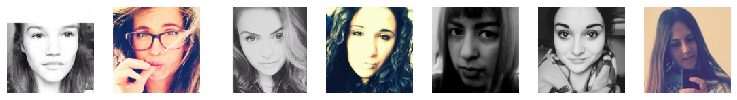

Customized Anime Version


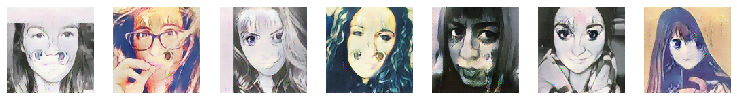

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_0/assets
Epoch:5, Step:0, D-Loss:0.038, D-Acc:100.000, G-Loss:2.076
Epoch:5, Step:100, D-Loss:0.055, D-Acc:97.656, G-Loss:2.217
Human Face Images


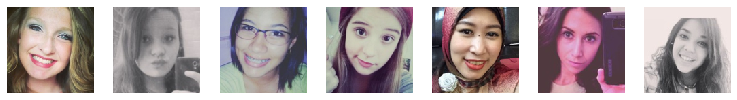

Customized Anime Version


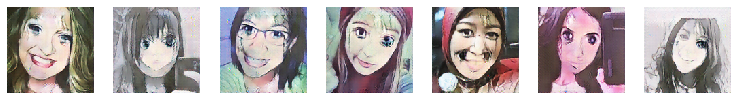

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_200/assets
Epoch:5, Step:200, D-Loss:0.119, D-Acc:91.406, G-Loss:2.289
Epoch:5, Step:300, D-Loss:0.142, D-Acc:79.688, G-Loss:2.004
Human Face Images


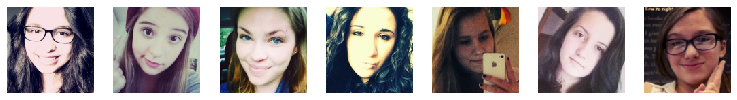

Customized Anime Version


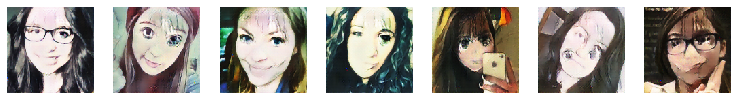

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_400/assets
Epoch:5, Step:400, D-Loss:0.021, D-Acc:100.000, G-Loss:2.137
Epoch:5, Step:500, D-Loss:0.081, D-Acc:94.531, G-Loss:2.279
Human Face Images


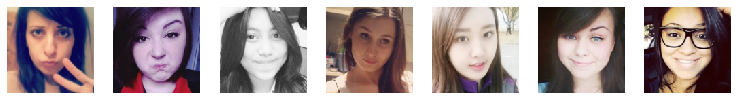

Customized Anime Version


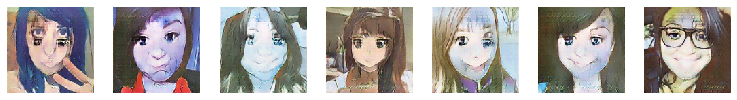

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_600/assets
Epoch:5, Step:600, D-Loss:0.048, D-Acc:99.219, G-Loss:2.222
Epoch:5, Step:700, D-Loss:0.079, D-Acc:96.094, G-Loss:2.105
Human Face Images


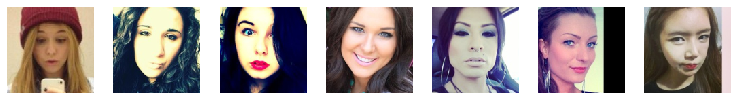

Customized Anime Version


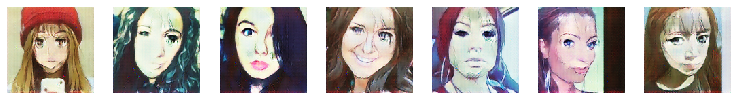

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_800/assets
Epoch:5, Step:800, D-Loss:0.014, D-Acc:100.000, G-Loss:2.151
Epoch:5, Step:900, D-Loss:0.022, D-Acc:100.000, G-Loss:2.414
Human Face Images


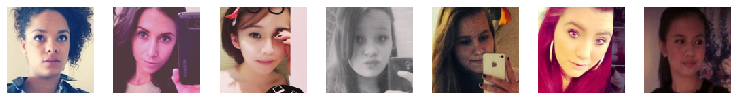

Customized Anime Version


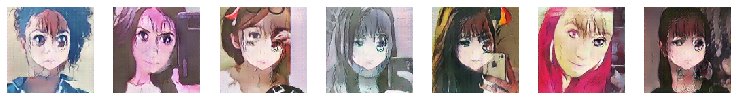

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_1000/assets
Epoch:5, Step:1000, D-Loss:0.131, D-Acc:81.250, G-Loss:2.090
Epoch:5, Step:1100, D-Loss:0.018, D-Acc:100.000, G-Loss:1.996
Human Face Images


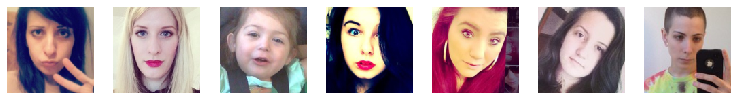

Customized Anime Version


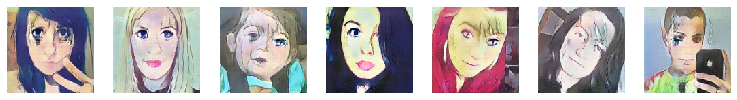

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_1200/assets
Epoch:5, Step:1200, D-Loss:0.023, D-Acc:100.000, G-Loss:2.209
Epoch:5, Step:1300, D-Loss:0.034, D-Acc:100.000, G-Loss:2.093
Human Face Images


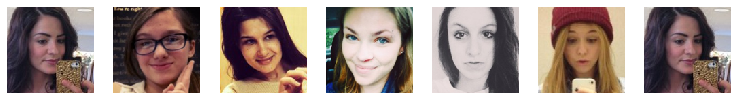

Customized Anime Version


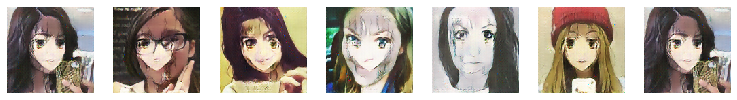

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_1400/assets
Epoch:5, Step:1400, D-Loss:0.245, D-Acc:53.906, G-Loss:1.852
Epoch:5, Step:1500, D-Loss:0.111, D-Acc:90.625, G-Loss:2.243
Human Face Images


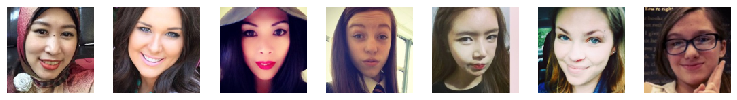

Customized Anime Version


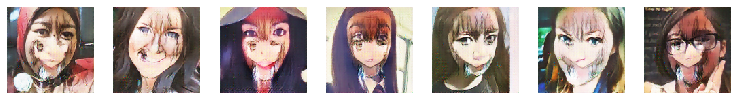

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_1600/assets
Epoch:5, Step:1600, D-Loss:0.035, D-Acc:100.000, G-Loss:2.608
Epoch:5, Step:1700, D-Loss:0.024, D-Acc:100.000, G-Loss:2.173
Human Face Images


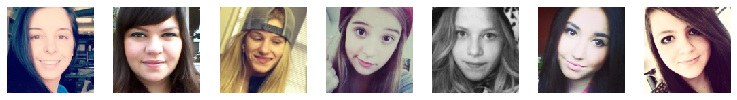

Customized Anime Version


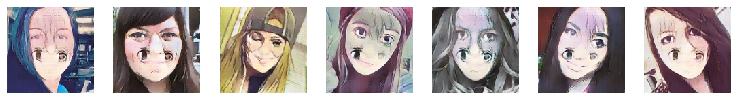

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_1800/assets
Epoch:5, Step:1800, D-Loss:0.038, D-Acc:100.000, G-Loss:2.110
Epoch:5, Step:1900, D-Loss:0.022, D-Acc:100.000, G-Loss:2.220
Human Face Images


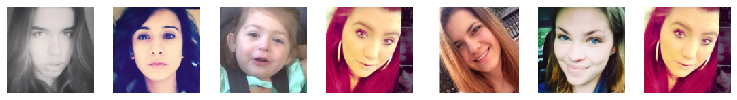

Customized Anime Version


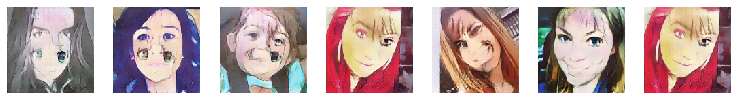

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_2000/assets
Epoch:5, Step:2000, D-Loss:0.016, D-Acc:100.000, G-Loss:2.434
Epoch:5, Step:2100, D-Loss:0.053, D-Acc:97.656, G-Loss:2.154
Human Face Images


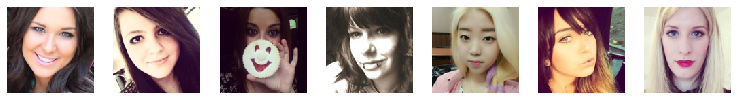

Customized Anime Version


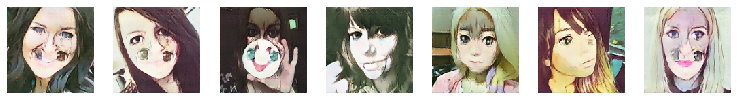

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_2200/assets
Epoch:5, Step:2200, D-Loss:0.026, D-Acc:100.000, G-Loss:2.233
Epoch:5, Step:2300, D-Loss:0.138, D-Acc:85.156, G-Loss:2.276
Human Face Images


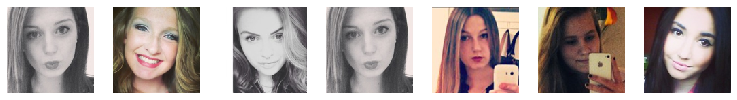

Customized Anime Version


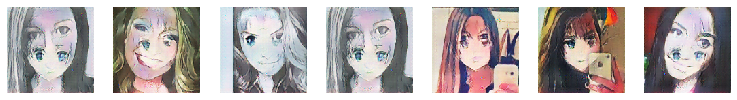

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_2400/assets
Epoch:5, Step:2400, D-Loss:0.030, D-Acc:100.000, G-Loss:2.296
Epoch:5, Step:2500, D-Loss:0.033, D-Acc:100.000, G-Loss:2.386
Human Face Images


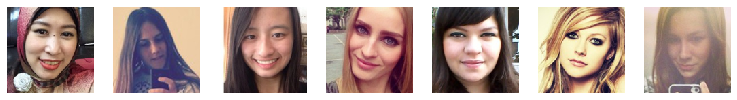

Customized Anime Version


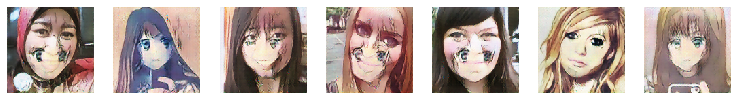

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_2600/assets
Epoch:5, Step:2600, D-Loss:0.036, D-Acc:100.000, G-Loss:2.456
Epoch:5, Step:2700, D-Loss:0.115, D-Acc:82.812, G-Loss:2.201
Human Face Images


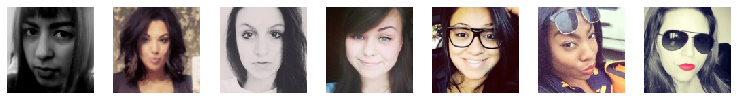

Customized Anime Version


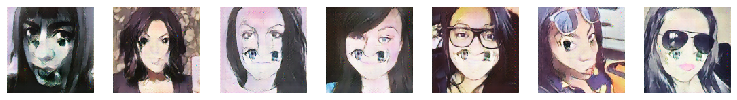

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_2800/assets
Epoch:5, Step:2800, D-Loss:0.032, D-Acc:100.000, G-Loss:2.316
Epoch:5, Step:2900, D-Loss:0.299, D-Acc:45.312, G-Loss:2.106
Human Face Images


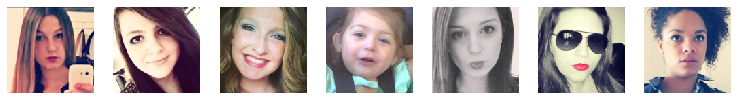

Customized Anime Version


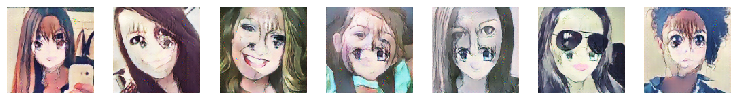

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_3000/assets
Epoch:5, Step:3000, D-Loss:0.068, D-Acc:96.875, G-Loss:1.835
Epoch:5, Step:3100, D-Loss:0.128, D-Acc:89.062, G-Loss:1.993
Human Face Images


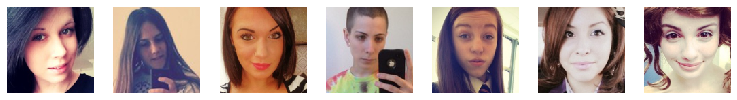

Customized Anime Version


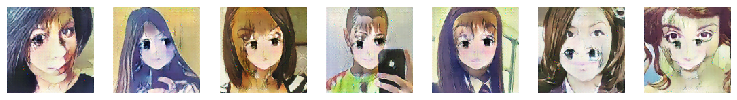

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_5_3200/assets
Epoch:5, Step:3200, D-Loss:0.020, D-Acc:100.000, G-Loss:2.219
Epoch:5, Step:3300, D-Loss:0.029, D-Acc:99.219, G-Loss:2.100
Human Face Images


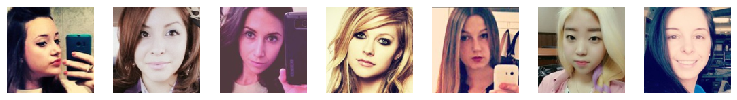

Customized Anime Version


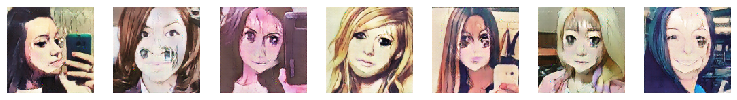

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_6_0/assets
Epoch:6, Step:0, D-Loss:0.055, D-Acc:100.000, G-Loss:2.199
Epoch:6, Step:100, D-Loss:0.010, D-Acc:100.000, G-Loss:2.180
Human Face Images


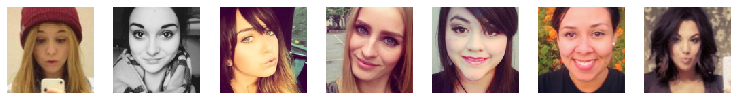

Customized Anime Version


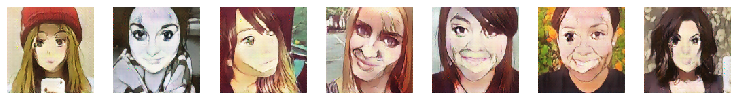

INFO:tensorflow:Assets written to: /Users/k15/Downloads/selfie2anime/weights/model_6_200/assets
Epoch:6, Step:200, D-Loss:0.030, D-Acc:100.000, G-Loss:2.052


KeyboardInterrupt: 

In [22]:
epochs = 500
batch_size = 1
steps = 3400

for i in range(0, epochs):
    # if i%1 == 0:
    #     show_generator_results(generator_network)
    for j in range(steps): 
        if j%200 == 0:
            show_generator_results(generator_network) 
            generator_network.save(path + "weights/model_" + str(i) + "_" + str(j))

        human_faces, anime_faces = get_training_samples(batch_size)

        fake_patch = np.zeros((batch_size, 8, 8, 1))
        real_patch = np.ones((batch_size, 8, 8, 1))
        
        custom_vgg.trainable=False
        styles = custom_vgg(anime_faces)
        fake_anime_faces = generator_network([human_faces, styles])
        
        # Updating Discriminator weights
        discriminator_network.trainable=True
        loss_d_real = discriminator_network.train_on_batch(anime_faces, real_patch)
        loss_d_fake = discriminator_network.train_on_batch(fake_anime_faces, fake_patch)

        loss_d = np.add(loss_d_real, loss_d_fake)/2.0
        
        # Make the Discriminator belive that these are real samples and calculate loss to train the generator
        discriminator_network.trainable=False
        # custom_vgg.trainable=False
        # y_true_features1 = custom_vgg(human_faces)
        # y_true_features2 = custom_vgg(anime_faces)

        # avg_features = np.add(y_true_features1, y_true_features2)/2.0

        # Updating Generator weights
        loss_g = face2anime_gan.train_on_batch([human_faces, styles],[real_patch, human_faces, anime_faces])
        
        if j%100 == 0:
            print ("Epoch:%.0f, Step:%.0f, D-Loss:%.3f, D-Acc:%.3f, G-Loss:%.3f"%(i,j,loss_d[0],loss_d[1]*100,loss_g[0]))
            

# Let's check on Male Faces :D 

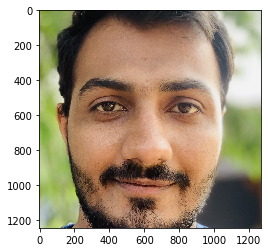

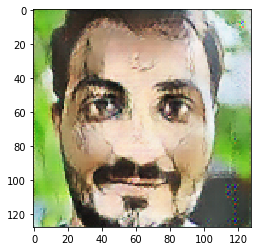

In [120]:
import tensorflow
import cv2
import matplotlib.pyplot as plt
model = tensorflow.keras.models.load_model('/Users/k15/Downloads/selfie2anime/weights/model_4_1200/')
img = cv2.imread('/Users/k15/Downloads/kartik1.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.show()
img2 = cv2.resize(img, (128, 128))
img2 = ((img2-127.5)/127.5)
human_faces, anime_faces = get_training_samples(1)
styles = custom_vgg(anime_faces)
anime = model([np.array([img2]), styles])[0]
anime = (anime + 1.0)/2.0
# plt.imshow(anime_faces[0])
# plt.show()
plt.imshow(anime)
plt.show()

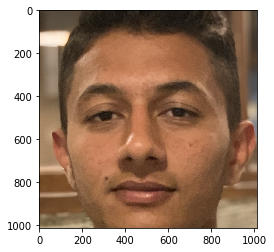

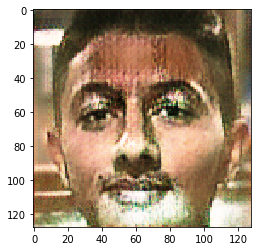

In [121]:
model = tensorflow.keras.models.load_model('/Users/k15/Downloads/selfie2anime/weights/model_1_2000/')
img = cv2.imread('/Users/k15/Downloads/brother.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.show()
img2 = cv2.resize(img, (128, 128))
img2 = ((img2-127.5)/127.5)
human_faces, anime_faces = get_training_samples(1)
styles = custom_vgg(anime_faces)
anime = model([np.array([img2]), styles])[0]
anime = (anime + 1.0)/2.0
# plt.imshow(anime_faces[0])
# plt.show()
plt.imshow(anime)
plt.show()